#0. Funciones y código auxiliar

##0.1. Instalar las bibliotecas necesarias

In [ ]:
import os
import glob
import yaml
import shutil
from ultralytics import YOLO
from google.colab import drive
from roboflow import Roboflow


In [1]:
!pip install ultralytics
!pip install roboflow
!pip install ultralytics -U

## 0.2 Funcion para distribuir los Datos

Funcion hecha para distribuir el porcentaje de los datos en las carpetas `train` , `valid` y  `test`.

In [2]:

import shutil
def redistribuir_dataset(input_dir, output_dir, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):
    print(f"\n INICIANDO REDISTRIBUCIÓN desde: {input_dir}")

    # Extensiones de imagen a buscar
    valid_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
    all_pairs = []

    splits = ['train', 'valid', 'test']

    for split in splits:
        # Rutas esperadas según tu descripción
        img_dir = os.path.join(input_dir, split, 'images')
        lbl_dir = os.path.join(input_dir, split, 'labels')

        if not os.path.exists(img_dir):
            continue

        # Listamos todas las imágenes de esta carpeta
        files = os.listdir(img_dir)
        count_split = 0

        for f in files:
            name, ext = os.path.splitext(f)
            if ext.lower() in valid_extensions:
                img_path = os.path.join(img_dir, f)
                lbl_path = os.path.join(lbl_dir, name + ".txt")

                # Solo añadimos si existe su etiqueta correspondiente
                if os.path.exists(lbl_path):
                    all_pairs.append((img_path, lbl_path))
                    count_split += 1

        print(f"   -> Recolectadas {count_split} parejas de '{split}'")

    total_files = len(all_pairs)
    print(f" TOTAL DE PARES ENCONTRADOS: {total_files}")

    if total_files == 0:
        print(" ERROR: No se encontraron pares imagen/etiqueta. Verifica las rutas.")
        return None

    # 2. Barajamos aleatoriamente (Shuffle)
    random.shuffle(all_pairs)

    # 3. Calculamos los puntos de corte
    i_train = int(total_files * train_ratio)
    i_val = i_train + int(total_files * val_ratio)

    # Dividimos la lista
    datasets = {
        'train': all_pairs[:i_train],
        'valid': all_pairs[i_train:i_val],
        'test': all_pairs[i_val:]
    }

    # 4. Copiamos a la nueva carpeta de destino
    if os.path.exists(output_dir):
        shutil.rmtree(output_dir) # Borramos si ya existe para empezar limpio

    print(f"\nCOPIANDO ARCHIVOS A: {output_dir} ...")

    for split, pairs in datasets.items():
        # Crear carpetas destino (ej: output/train/images)
        os.makedirs(os.path.join(output_dir, split, 'images'), exist_ok=True)
        os.makedirs(os.path.join(output_dir, split, 'labels'), exist_ok=True)

        for img_src, lbl_src in pairs:
            # Copiar Imagen
            shutil.copy(img_src, os.path.join(output_dir, split, 'images', os.path.basename(img_src)))
            # Copiar Label
            shutil.copy(lbl_src, os.path.join(output_dir, split, 'labels', os.path.basename(lbl_src)))

        print(f"   {split.upper()}: {len(pairs)} imágenes generadas.")

    # 5. Generar el nuevo archivo data.yaml
    # Intentamos leer los nombres de las clases del yaml original
    nombres_clases = []
    yaml_orig = os.path.join(input_dir, 'data.yaml')
    if os.path.exists(yaml_orig):
        try:
            with open(yaml_orig, 'r') as f:
                d = yaml.safe_load(f)
                nombres_clases = d.get('names', [])
        except: pass

    new_yaml = {
        'path': os.path.abspath(output_dir),
        'train': 'train/images',
        'val': 'valid/images',
        'test': 'test/images',
        'names': nombres_clases,
        'nc': len(nombres_clases)
    }

    with open(os.path.join(output_dir, 'data.yaml'), 'w') as f:
        yaml.dump(new_yaml, f)

    print(f"\n PROCESO COMPLETADO. nuevo dataset está en: {output_dir}")
    return output_dir

## 0.3 Función para analizar el Dataset

In [3]:
import os
import glob
import yaml
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import random
import numpy as np
from collections import Counter

def analyze_yolo_dataset(dataset_dir):


    # CARGAR CONFIGURACIÓN (CLASES)

    yaml_path = os.path.join(dataset_dir, "data.yaml")
    class_names = []

    if os.path.exists(yaml_path):
        with open(yaml_path, 'r') as f:
            data = yaml.safe_load(f)
            names = data.get('names', [])
            # Normalizar si viene como diccionario o lista
            if isinstance(names, dict):
                class_names = [names[i] for i in sorted(names.keys())]
            else:
                class_names = names
        print(f" Clases detectadas: {class_names}")
    else:
        print("ADVERTENCIA: No se encontró 'data.yaml'. Se usarán IDs numéricos.")


    #  ESTADÍSTICAS Y GRÁFICAS

    print("\n Generando estadísticas...")

    # Busca etiquetas recursivamente
    label_files = glob.glob(f'{dataset_dir}/**/labels/*.txt', recursive=True)
    class_counts = Counter()

    for lfile in label_files:
        with open(lfile, 'r') as f:
            lines = f.readlines()
            for line in lines:
                parts = line.strip().split()
                if len(parts) >= 5:
                    try:
                        cls_id = int(parts[0])
                        # Si tenemos nombres, usamos el nombre, si no, el ID
                        if class_names and 0 <= cls_id < len(class_names):
                            label = class_names[cls_id]
                        else:
                            label = str(cls_id)
                        class_counts[label] += 1
                    except ValueError: pass

    if class_counts:
        # Tabla
        print(f"\n{'CLASE':<30} | {'CANTIDAD':<10}")
        print("-" * 45)
        sorted_items = sorted(class_counts.items(), key=lambda x: x[1], reverse=True)
        for cls, count in sorted_items:
            print(f"{cls:<30} | {count:<10}")

        # Gráfico
        keys = [k for k, v in sorted_items]
        vals = [v for k, v in sorted_items]

        plt.figure(figsize=(12, 6))
        sns.barplot(x=keys, y=vals, hue=keys, legend=False, palette="viridis")
        plt.title(f"Distribución de Etiquetas (Total: {sum(vals)})")
        plt.xlabel("Clase")
        plt.ylabel("Frecuencia")
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        plt.show()

    else:
        print(" No se encontraron etiquetas válidas para graficar.")

    #  VISUALIZACIÓN DE IMÁGENES

    print("\n Generando ejemplos visuales...")

    all_images = glob.glob(f'{dataset_dir}/**/images/*.jpg', recursive=True) + \
                 glob.glob(f'{dataset_dir}/**/images/*.png', recursive=True) + \
                 glob.glob(f'{dataset_dir}/**/images/*.jpeg', recursive=True)

    if all_images:
        # Tomar hasta 6 muestras aleatorias
        samples = random.sample(all_images, min(len(all_images), 6))
        plt.figure(figsize=(15, 10))

        for i, img_path in enumerate(samples):
            img = cv2.imread(img_path)
            if img is None: continue
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            h, w, _ = img.shape

            # Buscar Label (Intenta ruta standard y fallback)
            label_path = img_path.replace('/images/', '/labels/').rsplit('.', 1)[0] + ".txt"
            if not os.path.exists(label_path):
                 # Intento alternativo para estructuras anidadas
                 label_path = os.path.join(os.path.dirname(os.path.dirname(img_path)), 'labels', os.path.basename(img_path).rsplit('.', 1)[0] + ".txt")

            box_drawn = False
            if os.path.exists(label_path):
                with open(label_path, 'r') as f:
                    for line in f:
                        parts = line.strip().split()
                        if len(parts) >= 5:
                            try:
                                cls_id = int(parts[0])
                                cx, cy, bw, bh = map(float, parts[1:5])

                                x1 = int((cx - bw/2) * w)
                                y1 = int((cy - bh/2) * h)
                                x2 = int((cx + bw/2) * w)
                                y2 = int((cy + bh/2) * h)

                                color = plt.cm.tab10(cls_id % 10)
                                color_rgb = (int(color[0]*255), int(color[1]*255), int(color[2]*255))

                                cv2.rectangle(img, (x1, y1), (x2, y2), color_rgb, 3)

                                # Texto
                                if class_names and cls_id < len(class_names):
                                    label_txt = class_names[cls_id]
                                else:
                                    label_txt = str(cls_id)

                                text_y = y1 - 10 if y1 > 25 else y1 + 25
                                cv2.putText(img, label_txt, (x1, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,0,0), 4)
                                cv2.putText(img, label_txt, (x1, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 2)
                                box_drawn = True
                            except ValueError: pass

            plt.subplot(2, 3, i+1)
            plt.imshow(img)
            plt.axis('off')

            # Nombre de la carpeta padre (train/valid/test)
            parent_folder = os.path.basename(os.path.dirname(os.path.dirname(img_path)))

            if box_drawn:
                plt.title(f"[{parent_folder}] Detectado", fontsize=10)
            else:
                plt.title(f"[{parent_folder}] Sana/Fondo", color='green', fontsize=10)

        plt.tight_layout()
        plt.show()

    else:
        print(" No se encontraron imágenes en la ruta proporcionada.")

## 0.4 Analizar Estructura Dataset

In [4]:

def analizar_estructura(dataset_dir):
    """
    Recorre las carpetas train, valid y test para contar imágenes.
    """
    if not dataset_dir or not os.path.exists(dataset_dir):
        print("El directorio del dataset no es válido.")
        return

    print(f"\nREPORTE DEL DATASET (Carpeta: {dataset_dir})")
    print("-" * 50)

    carpetas = ['train', 'valid', 'test']
    total_imgs = 0

    for carpeta in carpetas:
        ruta_split = os.path.join(dataset_dir, carpeta)
        ruta_imgs = os.path.join(ruta_split, 'images')

        # Verificar si 'images' está dentro o si es la raíz
        if not os.path.exists(ruta_imgs):
            ruta_imgs = ruta_split

        if os.path.exists(ruta_imgs) and os.path.isdir(ruta_imgs):
            # Se ha corregido el error tipográfico 'rutpatataa_imgs' aquí:
            imgs = glob.glob(os.path.join(ruta_imgs, '*.jpg')) + \
                   glob.glob(os.path.join(ruta_imgs, '*.jpeg')) + \
                   glob.glob(os.path.join(ruta_imgs, '*.png'))

            n = len(imgs)
            total_imgs += n
            print(f"{carpeta.upper()}: {n} imágenes encontradas.")
        else:
            if carpeta != 'test':
                print(f"{carpeta.upper()}: No encontrada.")

    print("-" * 50)
    print(f"TOTAL: {total_imgs} imágenes.")





## 0.5 Configurar Yaml

In [5]:
def configurar_yaml(dataset_dir):
    """
    Edita el archivo data.yaml para usar rutas absolutas y relativas correctas.
    """
    if not dataset_dir: return

    yaml_path = os.path.join(dataset_dir, "data.yaml")

    if os.path.exists(yaml_path):
        try:
            with open(yaml_path, 'r') as f:
                data = yaml.safe_load(f)

            # Ajuste de rutas
            data['path'] = os.path.abspath(dataset_dir)
            data['train'] = "train/images"
            data['val'] = "valid/images"
            data['test'] = "test/images"

            with open(yaml_path, 'w') as f:
                yaml.dump(data, f, default_flow_style=False)

            print(f"\nArchivo corregido: {yaml_path}")
            if 'names' in data:
                print(f"Clases: {data['names']}")

        except Exception as e:
            print(f"Error editando yaml: {e}")
    else:
        print("No se encontró 'data.yaml'.")




# 1. DATASET ROSAS
https://universe.roboflow.com/germanrv/rose-leaf-diseases-gboa4

Se ha utilizado un dataset , sobre enfermedades en Hojas de Rosas, el dataset tiene un tamaño de imagenes de 640 x 640 y 4 clases `Black Spot`, `	Downy Mildew` , `	Powdery Mildew` y `Normal` .

`Black Spot`(Mancha Negra) , una enfermedad fúngica que afecta comúnmente a las rosas (causada por Diplocarpon rosae) , manifestándose como manchas oscuras en hojas y frutos, debilitando las plantas y reduciendo su valor comercial.


`Downy Mildew` ( Mildiu Velloso), una enfermedad fúngica destructiva que causa manchas amarillas en el haz de las hojas y una pelusa grisácea en el envés, afectando a cultivos como pepinos, vides, brasicáceas (brócoli, col) y rosas, favorecida por la humedad y el clima fresco.


 `Powdery Mildew`( Oídio o Mildiu Polvoriento),es  una enfermedad fúngica que causa manchas blanquecinas polvorientas en hojas, tallos y frutos, chupando nutrientes y afectando la fotosíntesis, pudiendo llevar a la caída de hojas y a la muerte de la planta si no se controla, desarrollándose bien con calor y baja humedad, a diferencia del mildiu velloso.

 `Normal` Hoja sin enfermedad.

Para saber si utilizar el dataset con o sin data augmentation, realizaré una prueba sin data augmentation, y posteriormente sin. Al observar los resultados se decidirá cual es el mas conveniente .

Después de elegir el formato de dataset que queremos, se hará un torneo , es decir ejecutar varios modelos de yolo y elegir cual viene mejor para el proyecto (observando metricas como velocidad, precisión..).

## 1.1. Prueba sin data Augmentation

Emplearemos el dataset https://universe.roboflow.com/germanrv/rose-leaf-diseases-gboa4 en su versión "V2_NoDataAug"

En primer lugar , se descarga el dataset y se ve la organización de carpetas y numero de imagenes que contiene.Esto es importante para corroborar que se ha descargado correctamente.

### 1. Carga del dataset desde Roboflow

In [22]:
rf = Roboflow(api_key="optsSQIAxiNXEdI8izmp")
project = rf.workspace("germanrv").project("rose-leaf-diseases-gboa4")
version = project.version(5)
dataset = version.download("yolov11")


loading Roboflow workspace...
loading Roboflow project...


In [23]:
dataset_dir = dataset.location
print(f"\n Descarga completada en: {dataset_dir}")


 Descarga completada en: /content/rose-leaf-diseases-5


### 2. Configurar Yaml

Se configura el archivo Yaml, para poder utilizarlo mas adelante en el entrenamiento, lo que hace es poner las rutas bien para poder ser utilizadas.

In [24]:
if dataset_dir:
    configurar_yaml(dataset_dir)


Archivo corregido: /content/rose-leaf-diseases-5/data.yaml
Clases: ['Black Spot', 'Downy Mildew', 'Normal', 'Powdery Mildew']


### 2. Analizar Dataset

Con estas funciones podemos observar el numero de imagenes del dataset completo y en cada carpeta( para poder ver su distribución). Ademas de ver el numero de patches de cada clase y ejemplos visuales .

In [25]:
analizar_estructura(dataset_dir)


REPORTE DEL DATASET (Carpeta: /content/rose-leaf-diseases-5)
--------------------------------------------------
TRAIN: 1871 imágenes encontradas.
VALID: 427 imágenes encontradas.
TEST: 427 imágenes encontradas.
--------------------------------------------------
TOTAL: 2725 imágenes.


 Clases detectadas: ['Black Spot', 'Downy Mildew', 'Normal', 'Powdery Mildew']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
Powdery Mildew                 | 3321      
Black Spot                     | 2526      
Normal                         | 710       
Downy Mildew                   | 669       


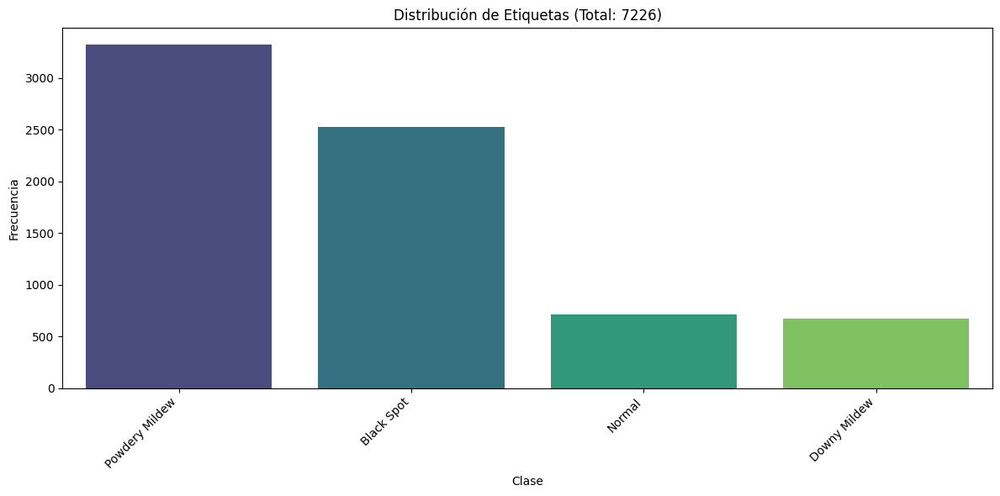


 Generando ejemplos visuales...


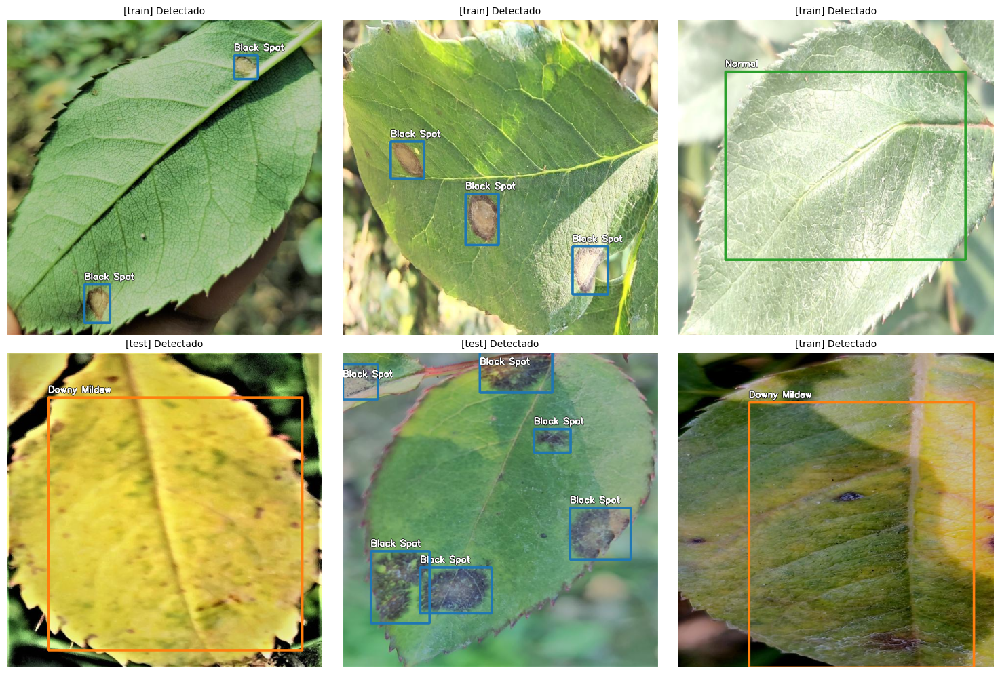

In [15]:
analyze_yolo_dataset( dataset_dir)

### 2. Entrenamiento

Ahora se procede al entrenamiento, parea ello guardo los datos en google drive , donde se pueden observar graficas, matrices de confusión ...

Los entrenamiento se realizaran con modelo yolo11 medium . Se puede llegar a mas precisión , al ser un conjunto de prueba y solo querer saber cual se comporta mejor  se dejara a 25 epocas.

In [16]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Rosas_NoAug"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir' not in globals():
    print("Error: La variable 'dataset_dir' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir}")

    ruta_yaml = os.path.join(dataset_dir, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_rosas_No_AUG'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/rose-leaf-diseases-5
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/rose-leaf-diseases-5/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_rosas_No_AUG

## 1.2 Prueba con data Augmentation

Emplearemos el dataset https://universe.roboflow.com/germanrv/rose-leaf-diseases-gboa4 en su versión "V2_DataAug"

 En este caso , utilizando las herramientas proporcionadas por roboflow, se le ha aplicado las siguientes transformaciones:


*  Flip: Horizontal, Vertical
*  90° Rotate: Clockwise, Counter-Clockwise, Upside Down
* Crop: 0% Minimum Zoom, 13% Maximum Zoom
*  Rotation: Between -6° and +6°
*  Saturation: Between -12% and +12%
*  rightness: Between -15% and +15%


###  1. Carga del dataset desde Roboflow

In [26]:
rf = Roboflow(api_key="optsSQIAxiNXEdI8izmp")
project = rf.workspace("germanrv").project("rose-leaf-diseases-gboa4")
version = project.version(6)
dataset = version.download("yolov11")

loading Roboflow workspace...
loading Roboflow project...


In [27]:
dataset_dir = dataset.location
print(f"\n Descarga completada en: {dataset_dir}")


 Descarga completada en: /content/rose-leaf-diseases-6


### 2. Configurar Yaml

In [28]:
if dataset_dir:
   configurar_yaml(dataset_dir)


Archivo corregido: /content/rose-leaf-diseases-6/data.yaml
Clases: ['Black Spot', 'Downy Mildew', 'Normal', 'Powdery Mildew']


### 3. Distribuir Datos

In [29]:
dataset_dir_final = redistribuir_dataset(dataset_dir, "/content/dataset_repartido")


 INICIANDO REDISTRIBUCIÓN desde: /content/rose-leaf-diseases-6
   -> Recolectadas 5613 parejas de 'train'
   -> Recolectadas 427 parejas de 'valid'
   -> Recolectadas 427 parejas de 'test'
 TOTAL DE PARES ENCONTRADOS: 6467

COPIANDO ARCHIVOS A: /content/dataset_repartido ...
   TRAIN: 4526 imágenes generadas.
   VALID: 970 imágenes generadas.
   TEST: 971 imágenes generadas.

 PROCESO COMPLETADO. Tu nuevo dataset está en: /content/dataset_repartido


### 4. Analizar dataset

In [30]:
analizar_estructura(dataset_dir_final)


REPORTE DEL DATASET (Carpeta: /content/dataset_repartido)
--------------------------------------------------
TRAIN: 4526 imágenes encontradas.
VALID: 970 imágenes encontradas.
TEST: 971 imágenes encontradas.
--------------------------------------------------
TOTAL: 6467 imágenes.


 Clases detectadas: ['Black Spot', 'Downy Mildew', 'Normal', 'Powdery Mildew']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
Powdery Mildew                 | 7793      
Black Spot                     | 5980      
Normal                         | 1690      
Downy Mildew                   | 1593      


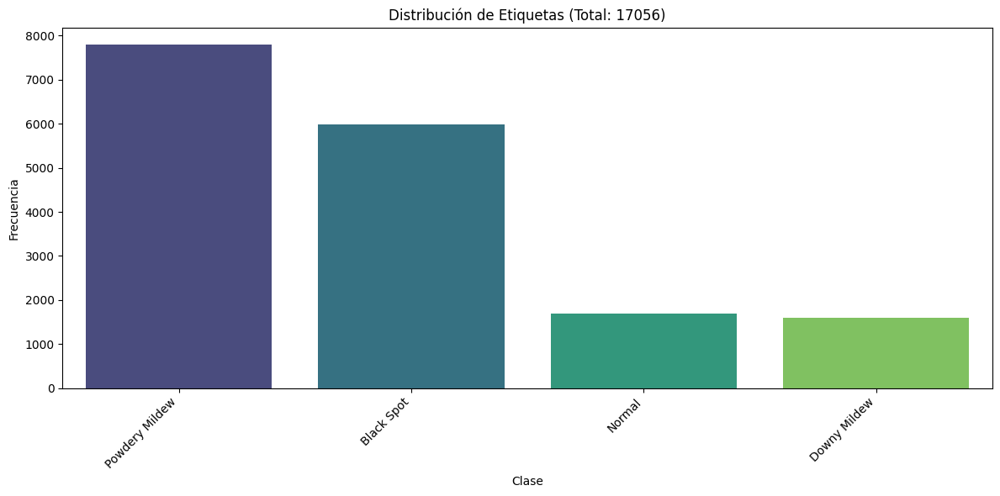


 Generando ejemplos visuales...


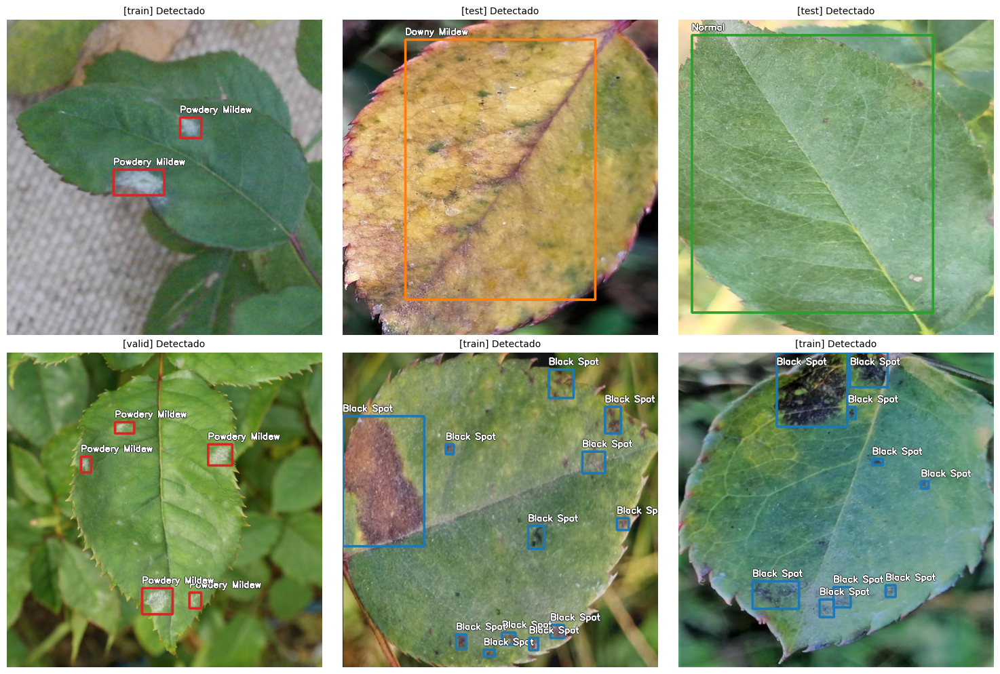

In [31]:
analyze_yolo_dataset( dataset_dir_final)

### 5. Entrenamiento

In [32]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Rosas_Aug"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir_final' not in globals():
    print("Error: La variable 'dataset_dir_final' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir_final}")

    ruta_yaml = os.path.join(dataset_dir_final, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_rosas_AUG'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/dataset_repartido
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_repartido/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_rosas_AUG, nbs=64,

## 1.3 Analisis de Resultados

Version sin Data Augmentation

           -     Class     Images  Instances      Box(P         R      mAP50     mAP50-95)
                   all        427       1039      0.882      0.862      0.909      0.518
            Black Spot        103        371      0.889      0.841      0.916      0.653
          Downy Mildew        102        103      0.887      0.914      0.893      0.495
                Normal        113        113      0.933      0.965      0.981      0.513
        Powdery Mildew        110        452      0.819       0.73      0.846      0.412

Version con Data Augmentation

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all        970       2445      0.904      0.882      0.922      0.539
            Black Spot        254        870       0.86      0.883      0.924      0.659
          Downy Mildew        254        260      0.945      0.927      0.949      0.535
                Normal        254        254      0.979      0.984      0.976      0.547
        Powdery Mildew        215       1061      0.833      0.732      0.841      0.414

Analizando los resultados se ve un ligera mejoria en el dataset con Data Augmentation  obteniendo mejores resultados en cada clase , por consecuencia sera elegido la version con Data Augmentation

Tras la ejecución de los experimentos y la evaluación de las métricas obtenidas en el conjunto de prueba, se ha llevado a cabo una comparativa exhaustiva entre la versión base (sin Data Augmentation) y la versión entrenada utilizando Data Augmentation.

**Comparativa Global de Rendimiento**

La evaluación cuantitativa determina que el modelo entrenado con Data Augmentation ofrece un desempeño superior en todas las métricas clave.

1. Precisión Media (mAP): La métrica más robusta para la detección de objetos, mAP50-95, experimentó un incremento del 0.518 en la versión base al 0.539 en la versión aumentada.

2. Precision  y Recall: Se observa un comportamiento más equilibrado y robusto en la versión con data Augmentation:
   - Precision: Aumentó de 0.882 a 0.904, lo que indica una reducción en los falsos positivos .
   - Recall: Aumentó de 0.862 a 0.882, lo que implica que el modelo es capaz de encontrar una mayor cantidad de instancias reales de enfermedad, reduciendo los falsos negativos.

**Análisis por Clases**

Al desglosar el rendimiento por cada tipología de enfermedad, se destacan los siguientes hallazgos:

- `Downy Mildew`: Fue la clase más beneficiada por el aumento de datos, pasando de un mAP50-95 de 0.495 a 0.535. Esto sugiere que las transformaciones geométricas y de color ayudaron al modelo a generalizar mejor las características visuales de este mildiu .
-` Normal` (Hojas sanas): Esta clase presenta el mejor rendimiento en ambos escenarios, alcanzando un mAP50-95 de 0.547 en la versión final. La alta precisión (0.979) confirma que el sistema es muy fiable para descartar falsas alarmas en hojas sanas.
- `Powdery Mildew`: Se identifica como la clase más compleja de detectar, manteniendo un rendimiento similar en ambos modelos (mAP50-95 en torno a 0.41). Esto sugiere que la variabilidad visual de este hongo requiere una atención específica en trabajos futuros, posiblemente debido a su similitud visual con otras manchas o reflejos.

**Robustez y Generalización**

Un factor crítico para la selección del mejor modelo es el tamaño del conjunto de evaluación. La versión con Data Augmentation fue validada sobre un conjunto de prueba  mayor (970 imágenes frente a 427). El hecho de obtener mejores métricas sobre un conjunto de datos más extenso y variado (más del doble de tamaño) aporta una mayor significancia estadística a los resultados. Esto confirma que el modelo no solo ha memorizado los datos de entrenamiento, sino que posee una capacidad de generalización superior ante nuevas muestras.



## 1.4 Torneo mejor version Yolo

In [ ]:
import gc
import torch
import os
import shutil
import yaml
from ultralytics import YOLO
from google.colab import drive

# CONFIGURACIÓN DEL TORNEO


# . Montar Drive
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta base del torneo en Drive
DRIVE_BASE = "/content/drive/MyDrive/Torneo_YOLO_Rosa"
os.makedirs(DRIVE_BASE, exist_ok=True)

# Definir los contendientes (Modelos)
contendientes = [
    # --- YOLOv5
    {"nombre": "yolov5s.pt",  "batch": 16},
    {"nombre": "yolov5m.pt",  "batch": 16},
    {"nombre": "yolov5l.pt",  "batch": 8},   # Batch reducido

    # --- YOLOv8 (
    {"nombre": "yolov8s.pt",  "batch": 16},
    {"nombre": "yolov8m.pt",  "batch": 16},
    {"nombre": "yolov8l.pt",  "batch": 8},

    # --- YOLOv10
    {"nombre": "yolov10s.pt", "batch": 16},
    {"nombre": "yolov10m.pt", "batch": 16},
    {"nombre": "yolov10l.pt", "batch": 8},

    # --- YOLO11
    {"nombre": "yolo11s.pt",  "batch": 16},
    {"nombre": "yolo11m.pt",  "batch": 16},
    {"nombre": "yolo11l.pt",  "batch": 8}
]

print(f"Total de modelos a comparar: {len(contendientes)}")
# . Asegurar data.yaml
if 'dataset_dir' in locals():
    yaml_path = f"{dataset_dir}/data.yaml"
    with open(yaml_path, 'r') as f:
        data = yaml.safe_load(f)
    data['path'] = os.path.abspath(dataset_dir)
    data['train'] = "train/images"
    data['val'] = "valid/images"
    data['test'] = "test/images"
    with open(yaml_path, 'w') as f:
        yaml.dump(data, f)
else:
    print(" ADVERTENCIA: Variable 'dataset_dir' no encontrada. Verifica la descarga.")


#  BUCLE DE COMBATE (ENTRENAMIENTO)

for i, luchador in enumerate(contendientes):
    modelo_archivo = luchador["nombre"]
    batch_size = luchador["batch"]
    nombre_combate = modelo_archivo.replace('.pt', '') # Ejemplo: yolov8s

    print("\n" + "="*60)
    print(f" RONDA {i+1}/{len(contendientes)}: Entrenando {nombre_combate} (Batch: {batch_size})")
    print("="*60)

    #  Limpieza de memoria (Fundamental en Colab)
    gc.collect()
    torch.cuda.empty_cache()

    try:
        #  Cargar modelo
        print(f"    Cargando pesos: {modelo_archivo}...")
        model = YOLO(modelo_archivo)

        #  Entrenar
        model.train(
            data=f"{dataset_dir}/data.yaml",
            epochs=25,                  # 25 épocas para el torneo
            imgsz=640,
            batch=batch_size,
            device=0 if torch.cuda.is_available() else 'cpu',
            project='Torneo_Local',     # Carpeta raíz en Colab
            name=nombre_combate,        # Subcarpeta (ej: yolov8s)
            patience=10,
            plots=True,
            verbose=True
        )
        print(f"   {nombre_combate} terminó el entrenamiento.")

        # Guardar resultados en Drive
        print(f"    Guardando estadísticas en Drive...")

        origen = f"/content/Torneo_Local/{nombre_combate}"
        destino = f"{DRIVE_BASE}/{nombre_combate}"

        if os.path.exists(destino):
            shutil.rmtree(destino)

        # Copiamos todo MENOS los pesos (.pt) para ahorrar espacio y tiempo
        shutil.copytree(
            origen,
            destino,
            ignore=shutil.ignore_patterns('weights', 'last.pt')

        )
        print(f"    Resultados de {nombre_combate} guardados.")

    except Exception as e:
        print(f"    Error entrenando {nombre_combate}: {e}")
        # Intentamos seguir con el siguiente modelo aunque este falle
        continue

print("\n" + "="*60)
print(" ¡TORNEO FINALIZADO!")
print(f" Revisa los resultados y gráficas en Drive: {DRIVE_BASE}")
print("="*60)

# 2. 2. Dataset PATATAS

https://universe.roboflow.com/germanrv/potatoes_leaf-diseases

## 2.1. Dataset PATATAS (SIN DataAugmentation)

Emplearemos el dataset https://universe.roboflow.com/germanrv/potatoes_leaf-diseases en su versión "V2_NoDataAug"

### 1. Carga del dataset desde Roboflow

In [36]:
rf = Roboflow(api_key="optsSQIAxiNXEdI8izmp")
project = rf.workspace("germanrv").project("potatoes_leaf-diseases")
version = project.version(4)
dataset = version.download("yolov11")

loading Roboflow workspace...
loading Roboflow project...


In [37]:
dataset_dir = dataset.location
print(f"\n Descarga completada en: {dataset_dir}")


 Descarga completada en: /content/Potatoes_leaf-diseases-4


### 2. Configurar Yaml

In [38]:
if dataset_dir:
    configurar_yaml(dataset_dir)


Archivo corregido: /content/Potatoes_leaf-diseases-4/data.yaml
Clases: ['early bright', 'healthy', 'late bright']


### 1. Prueba sin repartir

#### 1. Analizar Dataset

In [39]:
analizar_estructura(dataset_dir)


REPORTE DEL DATASET (Carpeta: /content/Potatoes_leaf-diseases-4)
--------------------------------------------------
TRAIN: 613 imágenes encontradas.
VALID: 101 imágenes encontradas.
TEST: 98 imágenes encontradas.
--------------------------------------------------
TOTAL: 812 imágenes.


 Clases detectadas: ['early bright', 'healthy', 'late bright']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
early bright                   | 6354      
late bright                    | 565       
healthy                        | 152       


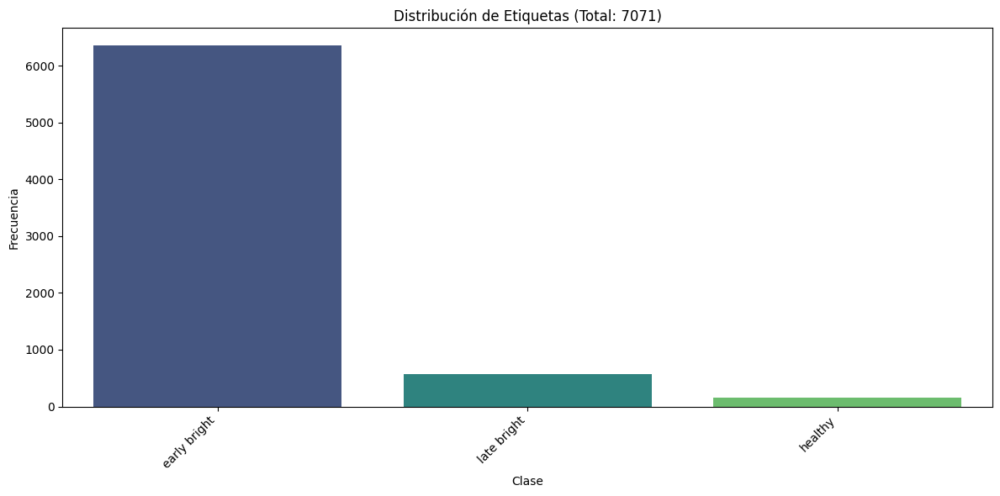


 Generando ejemplos visuales...


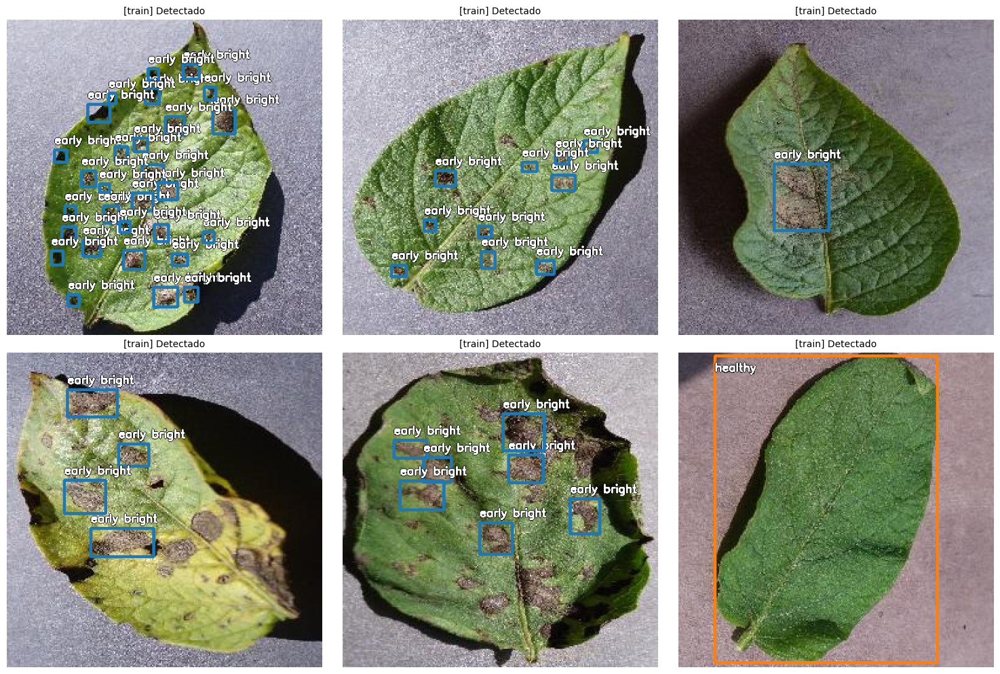

In [40]:
analyze_yolo_dataset( dataset_dir)

#### 2. Entrenamiento

In [41]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Patatas_No_Aug"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir' not in globals():
    print("Error: La variable 'dataset_dir' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir}")

    ruta_yaml = os.path.join(dataset_dir, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_patatas_No_AUG'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/Potatoes_leaf-diseases-4
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Potatoes_leaf-diseases-4/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_pata

### 2. Prueba con 70/15/15

#### 1. Distribuir Dataset

In [42]:
dataset_dir_final = redistribuir_dataset(dataset_dir, "/content/dataset_repartido")


 INICIANDO REDISTRIBUCIÓN desde: /content/Potatoes_leaf-diseases-4
   -> Recolectadas 613 parejas de 'train'
   -> Recolectadas 101 parejas de 'valid'
   -> Recolectadas 98 parejas de 'test'
 TOTAL DE PARES ENCONTRADOS: 812

COPIANDO ARCHIVOS A: /content/dataset_repartido ...
   TRAIN: 568 imágenes generadas.
   VALID: 121 imágenes generadas.
   TEST: 123 imágenes generadas.

 PROCESO COMPLETADO. Tu nuevo dataset está en: /content/dataset_repartido


#### 2. Analizar Dataset

In [43]:
analizar_estructura(dataset_dir_final)


REPORTE DEL DATASET (Carpeta: /content/dataset_repartido)
--------------------------------------------------
TRAIN: 568 imágenes encontradas.
VALID: 121 imágenes encontradas.
TEST: 123 imágenes encontradas.
--------------------------------------------------
TOTAL: 812 imágenes.


 Clases detectadas: ['early bright', 'healthy', 'late bright']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
early bright                   | 6354      
late bright                    | 565       
healthy                        | 152       


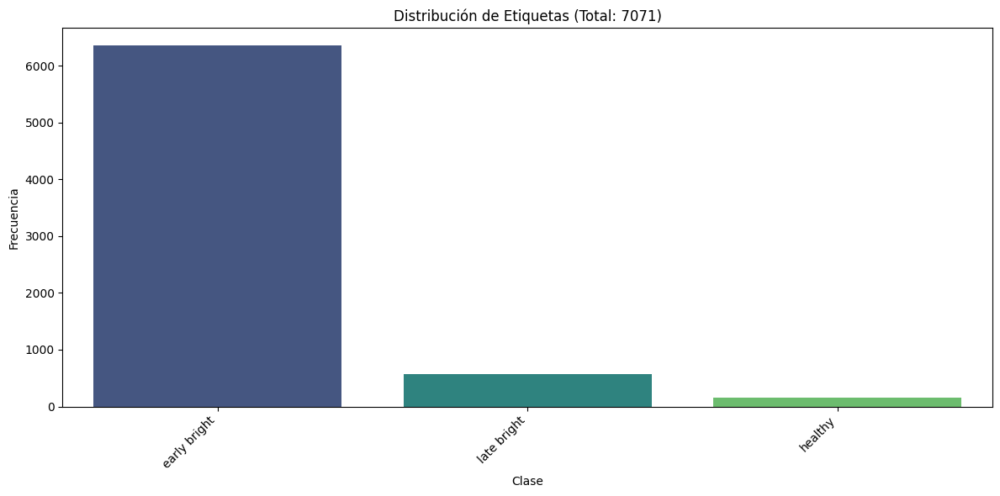


 Generando ejemplos visuales...


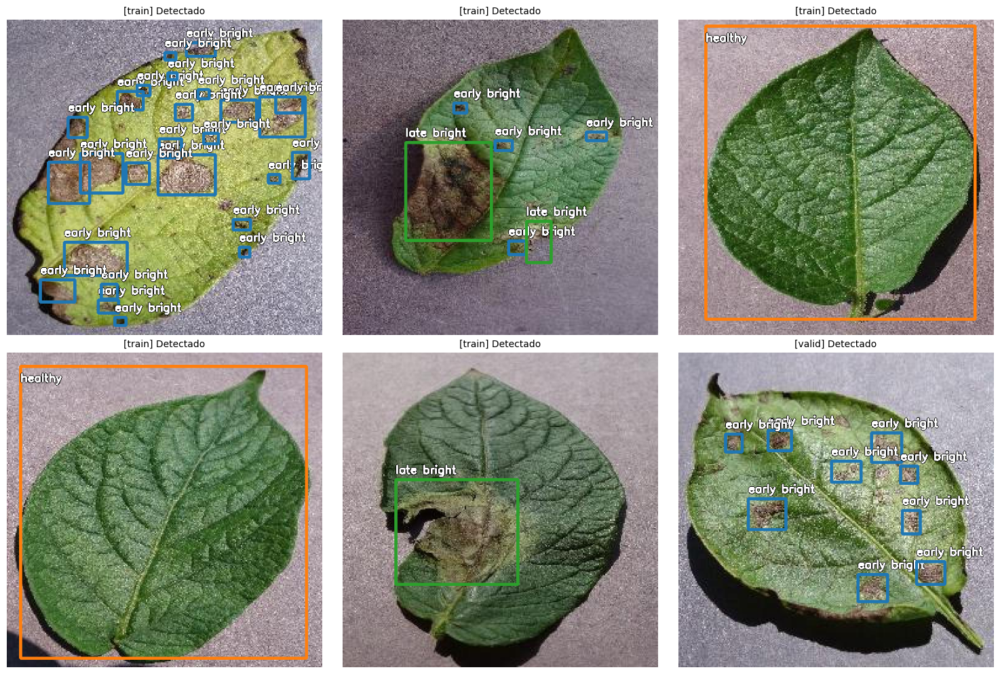

In [44]:
analyze_yolo_dataset( dataset_dir_final)

#### 4. Entrenamiento

In [45]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Patatas_No_Aug_70"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir_final' not in globals():
    print("Error: La variable 'dataset_dir_final' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir_final}")

    ruta_yaml = os.path.join(dataset_dir_final, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_patatas_AUG_70'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/dataset_repartido
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_repartido/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_patatas_AUG_70, nb

## 2.2. Dataset PATATAS (Con DataAugmentation)

Emplearemos el dataset https://universe.roboflow.com/germanrv/potatoes_leaf-diseases en su versión "V2_DataAug"

In [46]:

from roboflow import Roboflow
rf = Roboflow(api_key="optsSQIAxiNXEdI8izmp")
project = rf.workspace("germanrv").project("potatoes_leaf-diseases")
version = project.version(3)
dataset = version.download("yolov11")


loading Roboflow workspace...
loading Roboflow project...


In [47]:
dataset_dir = dataset.location
print(f"\n Descarga completada en: {dataset_dir}")


 Descarga completada en: /content/Potatoes_leaf-diseases-3


In [48]:
if dataset_dir:
    configurar_yaml(dataset_dir)


Archivo corregido: /content/Potatoes_leaf-diseases-3/data.yaml
Clases: ['early bright', 'healthy', 'late bright']


### Prueba sin repartir

#### 1. Analizar Dataset

In [49]:
analizar_estructura(dataset_dir)


REPORTE DEL DATASET (Carpeta: /content/Potatoes_leaf-diseases-3)
--------------------------------------------------
TRAIN: 1839 imágenes encontradas.
VALID: 101 imágenes encontradas.
TEST: 98 imágenes encontradas.
--------------------------------------------------
TOTAL: 2038 imágenes.


 Clases detectadas: ['early bright', 'healthy', 'late bright']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
early bright                   | 18068     
late bright                    | 1379      
healthy                        | 364       


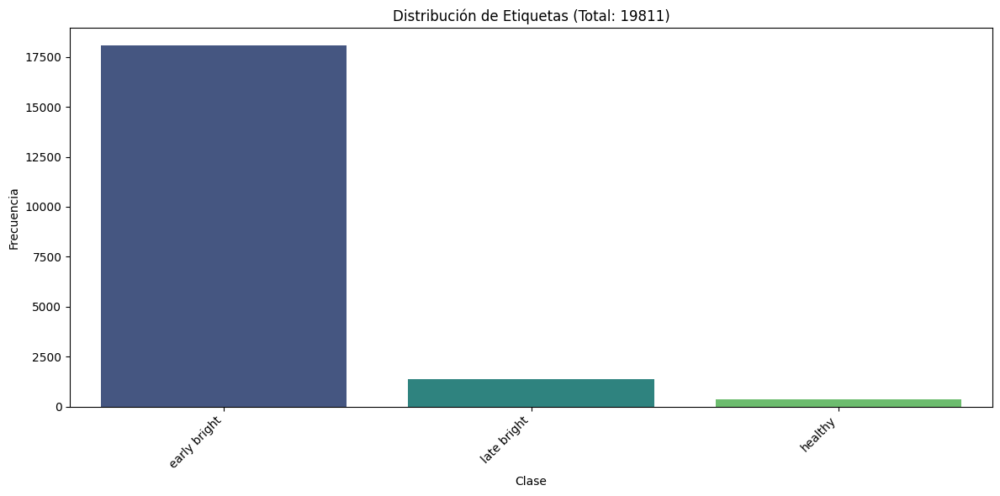


 Generando ejemplos visuales...


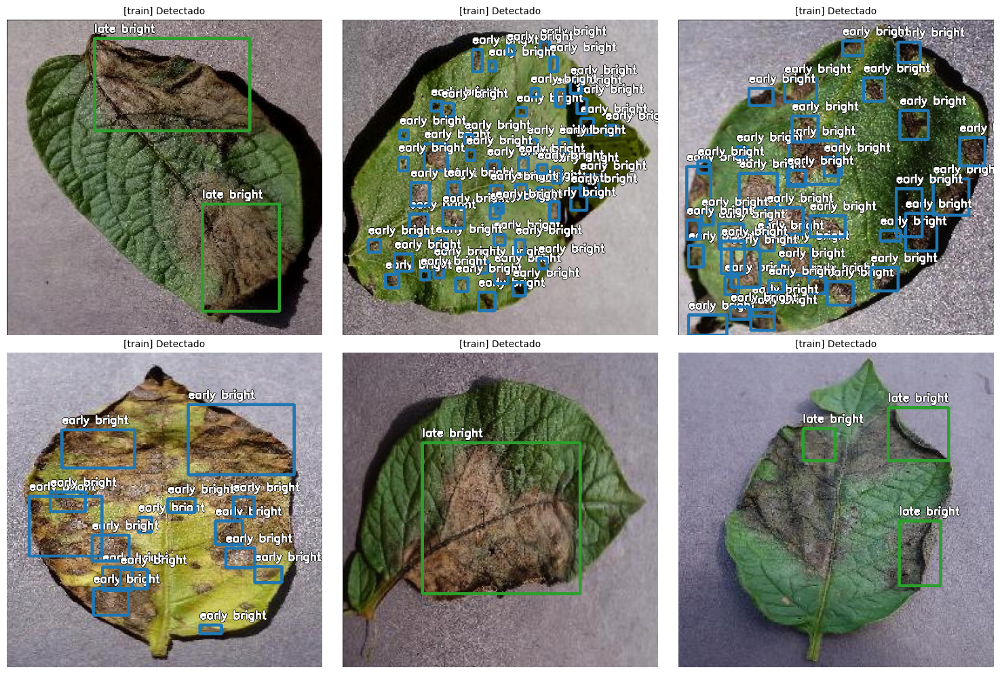

In [50]:
analyze_yolo_dataset( dataset_dir)

#### 2. Entrenamiento

In [51]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Patatas_Aug"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir' not in globals():
    print("Error: La variable 'dataset_dir' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir}")

    ruta_yaml = os.path.join(dataset_dir, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_patatas_AUG'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/Potatoes_leaf-diseases-3
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Potatoes_leaf-diseases-3/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_pata

### Prueba con 70/15/15

#### 1. Distribuir Dataset

In [52]:
dataset_dir_final = redistribuir_dataset(dataset_dir, "/content/dataset_repartido")


 INICIANDO REDISTRIBUCIÓN desde: /content/Potatoes_leaf-diseases-3
   -> Recolectadas 1839 parejas de 'train'
   -> Recolectadas 101 parejas de 'valid'
   -> Recolectadas 98 parejas de 'test'
 TOTAL DE PARES ENCONTRADOS: 2038

COPIANDO ARCHIVOS A: /content/dataset_repartido ...
   TRAIN: 1426 imágenes generadas.
   VALID: 305 imágenes generadas.
   TEST: 307 imágenes generadas.

 PROCESO COMPLETADO. Tu nuevo dataset está en: /content/dataset_repartido


#### 2. Analizar Dataset

In [53]:
analizar_estructura(dataset_dir)


REPORTE DEL DATASET (Carpeta: /content/Potatoes_leaf-diseases-3)
--------------------------------------------------
TRAIN: 1839 imágenes encontradas.
VALID: 101 imágenes encontradas.
TEST: 98 imágenes encontradas.
--------------------------------------------------
TOTAL: 2038 imágenes.


 Clases detectadas: ['early bright', 'healthy', 'late bright']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
early bright                   | 18068     
late bright                    | 1379      
healthy                        | 364       


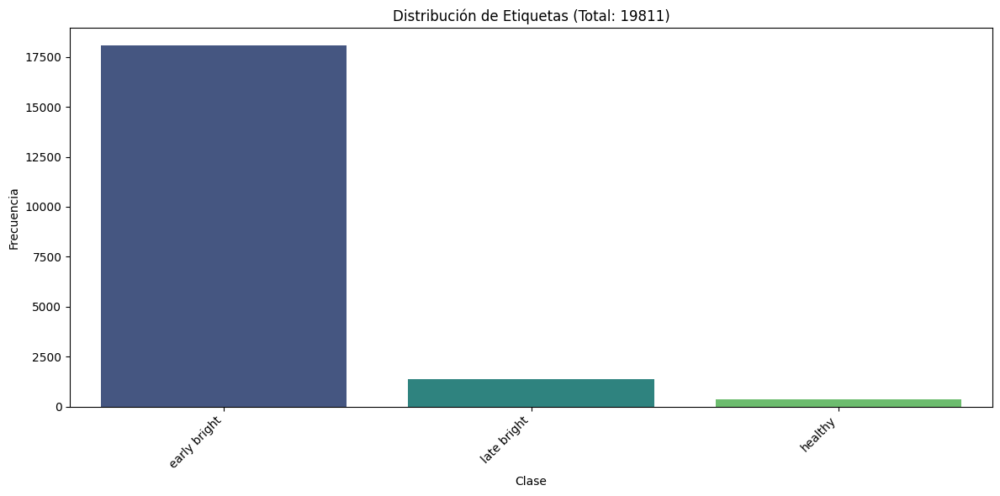


 Generando ejemplos visuales...


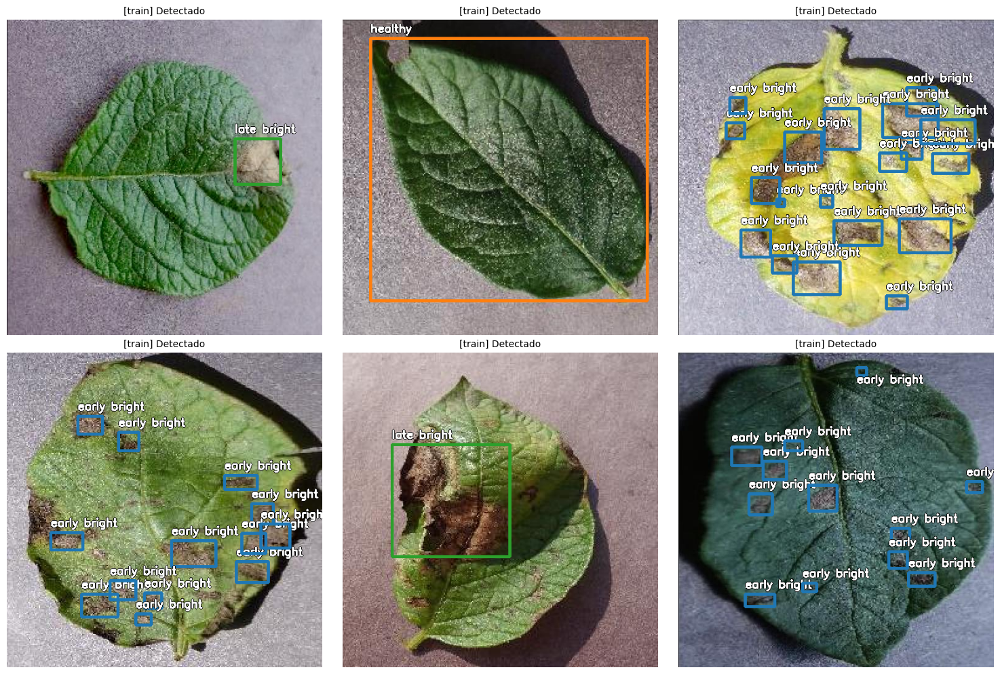

In [54]:
analyze_yolo_dataset( dataset_dir)

#### 3. Entrenamiento

In [55]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Patatas_Aug_70"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir_final' not in globals():
    print("Error: La variable 'dataset_dir_final' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir_final}")

    ruta_yaml = os.path.join(dataset_dir_final, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_patatas_AUG_70'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/dataset_repartido
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_repartido/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_patatas_AUG_702, n

### Prueba 80/10/10

#### 1. Distribuir Dataset

In [57]:
dataset_dir_final = redistribuir_dataset(dataset_dir, "/content/dataset_repartido",0.8,0.1,0.1)


 INICIANDO REDISTRIBUCIÓN desde: /content/Potatoes_leaf-diseases-3
   -> Recolectadas 1839 parejas de 'train'
   -> Recolectadas 101 parejas de 'valid'
   -> Recolectadas 98 parejas de 'test'
 TOTAL DE PARES ENCONTRADOS: 2038

COPIANDO ARCHIVOS A: /content/dataset_repartido ...
   TRAIN: 1630 imágenes generadas.
   VALID: 203 imágenes generadas.
   TEST: 205 imágenes generadas.

 PROCESO COMPLETADO. Tu nuevo dataset está en: /content/dataset_repartido


#### 2. Analizar Dataset

In [58]:
analizar_estructura(dataset_dir)


REPORTE DEL DATASET (Carpeta: /content/Potatoes_leaf-diseases-3)
--------------------------------------------------
TRAIN: 1839 imágenes encontradas.
VALID: 101 imágenes encontradas.
TEST: 98 imágenes encontradas.
--------------------------------------------------
TOTAL: 2038 imágenes.


 Clases detectadas: ['early bright', 'healthy', 'late bright']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
early bright                   | 18068     
late bright                    | 1379      
healthy                        | 364       


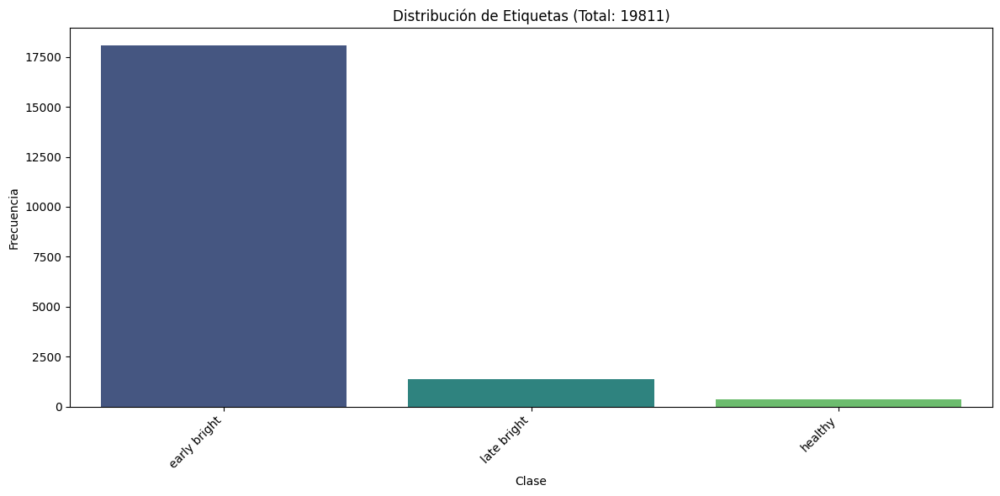


 Generando ejemplos visuales...


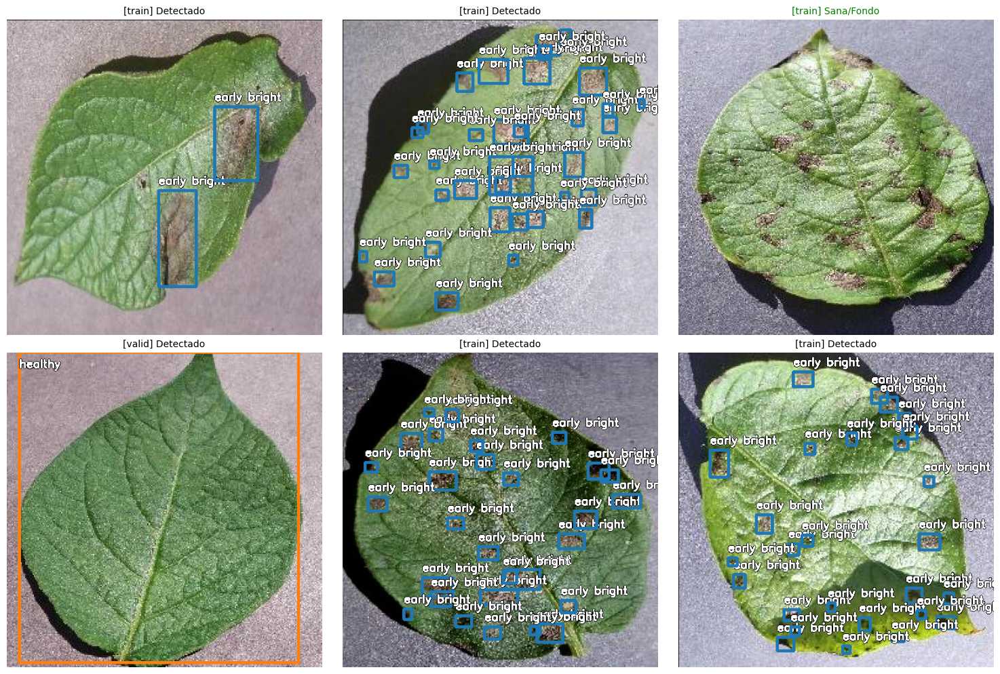

In [59]:
analyze_yolo_dataset( dataset_dir)

#### 3. Entrenamiento

In [60]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Patatas_Aug_80"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir_final' not in globals():
    print("Error: La variable 'dataset_dir_final' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir_final}")

    ruta_yaml = os.path.join(dataset_dir_final, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_patatas_AUG_80'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/dataset_repartido
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_repartido/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_patatas_AUG_80, nb

## 2.3 Analisis de Resultados

Version No Data

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all        101        194      0.663      0.724      0.686      0.492
          early bright         22         68      0.271      0.529      0.321      0.208
               healthy         31         31      0.977          1      0.995      0.959
           late bright         60         95      0.741      0.642      0.742      0.308

Version No Data 70/15/15

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all        121       1049      0.729      0.743      0.753      0.525
          early bright         64        953      0.616      0.686      0.657      0.442
               healthy         24         24      0.965          1      0.995      0.874
           late bright         48         72      0.607      0.542      0.608       0.26

Version Data

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all        101        194      0.694      0.736      0.706      0.505
          early bright         22         68      0.377      0.544      0.369      0.233
               healthy         31         31      0.982          1      0.995      0.966
           late bright         60         95      0.724      0.663      0.755      0.317

Version Data 70/15/15

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all        305       2792      0.798      0.781      0.801      0.582
          early bright        159       2531      0.659       0.74      0.723      0.481
               healthy         56         56      0.983          1      0.995      0.964
           late bright        134        205      0.751      0.603      0.685      0.301

Version Data 80/10/10

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all        203       1820      0.811      0.789      0.801      0.581
          early bright        111       1616      0.633      0.749      0.687      0.442
               healthy         32         32      0.978          1      0.995      0.971
           late bright         88        172      0.822      0.619       0.72       0.33

Tras realizar una comparativa exhaustiva entre las diferentes configuraciones de entrenamiento y distribución de datos , se ha determinado que la mejor version corresponde al modelo entrenado con la distribución 70/15/15 con Data Augmentation.Se ha decidido siguiendo estas metricas:

1. Superioridad en la Métrica Global (mAP)
El indicador más robusto para evaluar la precisión general de un modelo de detección de objetos es el mAP50-95. La versión 70/15/15 con Data Augmentation obtuvo el valor más alto con un 0.582, superando técnicamente a la versión 80/10/10 (0.581) y mostrando una mejora  significativa respecto a las versiones base (0.492 y 0.505).

2. Desempeño en Clases Críticas
El análisis detallado por clases revela que la versión 70/15/15 gestiona mejor la clase más compleja y abundante del conjunto de datos `early bright`. Esta clase cuenta con 2531 instancias (frente a las pocas cientos de las otras clases) y suele ser la más difícil de detectar debido a la sutileza de los síntomas tempranos. En esta categoría específica, el modelo seleccionado alcanzó un mAP50-95 de 0.481, superando notablemente el 0.442 obtenido por la versión 80/10/10. Esto demuestra que el modelo 70/15/15 tiene una mayor capacidad de generalización.

3. Confiabilidad de la Validación
Un factor determinante para la elección es la representatividad de los resultados. La versión 70/15/15 fue evaluada sobre un conjunto de validación de 305 imágenes, a diferencia de las 203 imágenes utilizadas en la versión 80/10/10 o las 101 imágenes de las versiones iniciales.

